<a href="https://colab.research.google.com/github/LyanhVini/FacialMetricLearning-MaskedFaceRecognition/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Nesse tarefa, você precisará fazer o seguinte:
1. Treinar um modelo de rede neural nesse conjunto de dados.
  - O conjunto de dados possui uma grande variedade de celebridades.
2. Uma vez treinado o modelo, você deve criar um banco de dados com as imagens das
celebridades com o output do vetor descritor do seu modelo.
3. Após o treinamento da rede neural você deve incluir essa pessoa no banco de dados.
4. Uma vez concluídas as etapas (1), (2) e (3), você deve usar esta imagem, que é a pessoa do
item (3) usando máscara facial, e fazer o reconhecimento facial dela.


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import cv2 as cv
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

## Carregando e processando o dataset

In [ ]:
!unzip /content/drive/MyDrive/IA/datasets/post-processed.zip

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: post-processed/Michael_Goldrich/Michael_Goldrich_0001_0000.jpg  
  inflating: post-processed/Michael_Goldrich/Michael_Goldrich_0001_0001.jpg  
  inflating: post-processed/Michael_Goldrich/Michael_Goldrich_0002_0000.jpg  
  inflating: post-processed/Michael_Goldrich/Michael_Goldrich_0002_0001.jpg  
  inflating: post-processed/Michael_Goldrich/Michael_Goldrich_0002_0002.jpg  
   creating: post-processed/Michael_Hagee/
  inflating: post-processed/Michael_Hagee/Michael_Hagee_0001_0000.jpg  
  inflating: post-processed/Michael_Hagee/Michael_Hagee_0002_0000.jpg  
   creating: post-processed/Michael_Haneke/
  inflating: post-processed/Michael_Haneke/Michael_Haneke_0001_0000.jpg  
  inflating: post-processed/Michael_Haneke/Michael_Haneke_0001_0001.jpg  
  inflating: post-processed/Michael_Haneke/Michael_Haneke_0002_0000.jpg  
  inflating: post-processed/Michael_Haneke/Michael_Haneke_0004_0000.jpg  
  inflating: post-proces

In [ ]:
img = cv.imread("/content/post-processed/AJ_Lamas/AJ_Lamas_0001_0000.jpg")
img

array([[[209, 195, 176],
        [212, 198, 179],
        [216, 202, 184],
        ...,
        [241, 224, 203],
        [238, 224, 202],
        [241, 227, 204]],

       [[212, 198, 179],
        [216, 202, 183],
        [220, 206, 188],
        ...,
        [241, 224, 205],
        [239, 225, 203],
        [241, 227, 204]],

       [[219, 203, 186],
        [223, 207, 190],
        [227, 211, 194],
        ...,
        [241, 226, 207],
        [241, 227, 205],
        [242, 228, 206]],

       ...,

       [[ 10,  15,  24],
        [  8,  13,  22],
        [  9,  14,  23],
        ...,
        [  7,  12,  11],
        [  7,   9,   9],
        [ 11,  11,  11]],

       [[  9,  15,  26],
        [  9,  15,  26],
        [ 18,  24,  35],
        ...,
        [  9,  14,  12],
        [ 11,  14,  12],
        [ 14,  15,  13]],

       [[ 18,  24,  35],
        [ 13,  19,  30],
        [ 23,  29,  40],
        ...,
        [  8,  13,  11],
        [ 12,  15,  13],
        [ 15,  16,  14]]

(112, 112, 3)

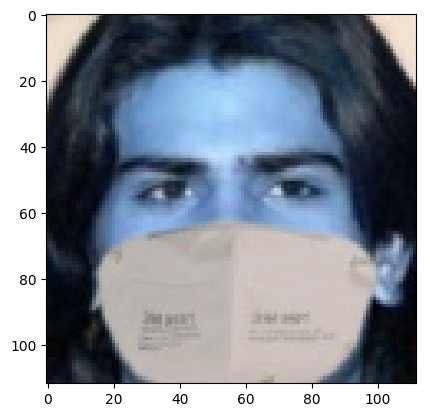

In [ ]:
plt.imshow(img)
img.shape

In [ ]:
class DatasetLoader:
    """
    Classe responsável por carregar os dados de imagens dentro das subpastas.
    Ela carrega as imagens e seus rótulos em duas listas self.X e self.Y
    """
    def __init__(self, directory):
        self.directory = directory
        self.x = []
        self.y = []

    def load_images_from_folder(self, folder): # Acessando as pastas
        images = []
        for filename in os.listdir(folder):
            path = os.path.join(folder, filename)
            img = cv.imread(path)
            if img is not None:
                images.append(img)
        return images

    def load_dataset(self): # Carregando o dataset
        for sub_dir in os.listdir(self.directory):
            path = os.path.join(self.directory, sub_dir)
            images = self.load_images_from_folder(path)
            if len(images) > 0:
                self.x.extend(images)
                self.y.extend([sub_dir] * len(images))
                print(f"Loaded successfully: {sub_dir} - {len(images)} images")

        self.x = np.asarray(self.x)
        self.y = np.asarray(self.y)

        return self.x, self.y

In [ ]:
# Carregando as imagens e os rótulos nas variáveis X e Y
faceloading = DatasetLoader("/content/post-processed")
x, y = faceloading.load_dataset()

Loaded successfully: Terry_Gilliam - 2 images
Loaded successfully: Gene_Robinson - 6 images
Loaded successfully: Todd_MacCulloch - 5 images
Loaded successfully: Porter_Goss - 2 images
Loaded successfully: James_Comey - 2 images
Loaded successfully: Richard_Tubb - 2 images
Loaded successfully: Scott_Wolf - 5 images
Loaded successfully: Phil_Bennett - 2 images
Loaded successfully: David_Heyman - 3 images
Loaded successfully: Ronald_Harwood - 2 images
Loaded successfully: Teddy_Kollek - 2 images
Loaded successfully: Chan_Ho_Park - 2 images
Loaded successfully: Evgeni_Plushenko - 2 images
Loaded successfully: Alex_Penelas - 4 images
Loaded successfully: Kate_Winslet - 9 images
Loaded successfully: Ernie_Eves - 3 images
Loaded successfully: Inam-ul-Haq - 2 images
Loaded successfully: Brad_Brownell - 2 images
Loaded successfully: Kurt_Russell - 12 images
Loaded successfully: Eunice_Barber - 4 images
Loaded successfully: Lisa_Murkowski - 8 images
Loaded successfully: Gary_Bergeron - 2 images


In [ ]:
print(x.shape) # contém os valores dos pixels das imagens
print(y.shape) # contém os rótulos

(12000, 112, 112, 3)
(12000,)


## Treinar um modelo de rede neural (FaceNet)
- OBS: Foi utilizado um modelo pré treinado do keras por conta das limitações dos recursos da ferramenta Google Colab

In [ ]:
!pip install keras-facenet

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 10.5 MB/s eta 0:00:00
  Created wheel for keras-facenet: filename=keras_facenet-0.3.2-py3-none-any.whl size=10369 sha256=cef951c5de492c4a026fcd7e4c7e517e956acc1997d385ef62548dc14678a72f
  Stored in directory: /root/.cache/pip/wheels/1d/d8/a9/85cf04ea29321d2afcb82c0caaafdca9195385f9d68cbc7185
Successfully built keras-facenet


In [ ]:
from keras_facenet import FaceNet

embedder = FaceNet()

# Função responsável por capturar os embeddings das faces baseada em FaceNet
def get_embedding(face_img):
    face_img = face_img.astype('float32') # 3D(160x160x3)
    face_img = np.expand_dims(face_img, axis=0)
    # 4D (Nonex160x160x3)
    yhat= embedder.embeddings(face_img)
    return yhat[0] # 512D image (1x1x512)

In [ ]:
embedded_x = []

for img in x:
    embedded_x.append(get_embedding(img))

embedded_x = np.asarray(embedded_x)

A saída de streaming foi truncada nas últimas 5000 linhas.
1/1 [==============================] - 0s 44ms/step


In [ ]:
print(embedded_x.shape)

(12000, 512)


In [ ]:
# salvando o dataset
np.savez_compressed('faces_embeddings_done_4classes.npz', embedded_x, y)

In [ ]:
data = np.load('/content/drive/MyDrive/IA/Models train/faces_embeddings_done_4classes.npz')
embedded_x = data['arr_0']
y = data['arr_1']

In [ ]:
print(len(y))
print(len(embedded_x))

12000
12000


In [ ]:
# Verificando a estrutura dos dados:
print(data.keys())

for key in data.keys():
    print(f"Conteúdo associado à chave '{key}':")
    print(data[key])

KeysView(<numpy.lib.npyio.NpzFile object at 0x7a27744142b0>)
Conteúdo associado à chave 'arr_0':
[[ 0.0995102  -0.03423122 -0.03635314 ... -0.03109727 -0.0376796
  -0.04277092]
 [ 0.02970203  0.03976062  0.02681468 ...  0.0584911   0.00916982
  -0.1329359 ]
 [ 0.01542085 -0.00825642 -0.07619616 ... -0.00574975 -0.03298084
  -0.05289617]
 ...
 [ 0.04431466 -0.00416402  0.02492798 ...  0.01651867 -0.05931062
   0.02731762]
 [ 0.03571893  0.0057285  -0.00946497 ... -0.02220044 -0.03114828
   0.02756602]
 [ 0.02232194  0.02902262 -0.00152218 ...  0.0274827  -0.02768276
   0.04626486]]
Conteúdo associado à chave 'arr_1':
['David_Brinkley' 'David_Brinkley' 'Joseph_Estrada' ... 'Sepp_Blatter'
 'Sepp_Blatter' 'Sepp_Blatter']


## Criar um banco de dados com as imagens das celebridades com o output do vetor descritor do seu modelo

- O banco de dados é um dicionário que contém: a face da pessoa (img), os embeddings e o rótulo da pessoa (Y)

In [ ]:
celebrity_data = {}

# Estrutura para cria o banco de dados
for i, img in enumerate(x):
    # Obter o embedding da imagem
    embedding = get_embedding(img)
    # Salvar a imagem e o embedding no dicionário
    celebrity_data[i] = {
        'image': img,
        'embedding': embedding,
        'label': y[i]
    }

A saída de streaming foi truncada nas últimas 5000 linhas.
1/1 [==============================] - 0s 48ms/step


In [ ]:
# salvando o banco de dados
np.savez_compressed('celebrity_database.npz', data=celebrity_data)

In [ ]:
celebrity_data

{0: {'image': array([[[ 34,  48,  42],
          [ 92, 106, 102],
          [132, 145, 143],
          ...,
          [ 10,   6,   5],
          [ 10,   6,   5],
          [ 10,   6,   5]],
  
         [[ 51,  65,  61],
          [141, 154, 152],
          [133, 145, 145],
          ...,
          [ 10,   6,   5],
          [ 10,   6,   5],
          [ 10,   6,   5]],
  
         [[ 98, 111, 113],
          [131, 144, 146],
          [147, 159, 163],
          ...,
          [ 10,   6,   5],
          [ 10,   6,   5],
          [ 10,   6,   5]],
  
         ...,
  
         [[  9,  14,  45],
          [  8,  17,  50],
          [ 19,  32,  70],
          ...,
          [ 20,  24,  49],
          [ 24,  29,  54],
          [ 17,  22,  47]],
  
         [[  0,   4,  28],
          [  5,  16,  44],
          [ 72,  79, 118],
          ...,
          [ 21,  23,  53],
          [ 25,  27,  58],
          [ 19,  21,  52]],
  
         [[  0,  10,  32],
          [ 18,  29,  56],
          [ 

In [ ]:
dados_completos = np.load('/content/drive/MyDrive/IA/Models train/celebrity_database.npz', allow_pickle=True)
dados_completos

### Descomprimindo os dados de celebrity_database.npz para poder acrescendo a nova pessoa na base de dados

In [ ]:
celebrity_data_restored = dados_completos['data'].item()
celebrity_data_restored

{0: {'image': array([[[ 3, 24, 22],
          [ 1, 22, 20],
          [ 0, 21, 19],
          ...,
          [11, 19, 12],
          [14, 20, 15],
          [15, 21, 16]],
  
         [[ 5, 23, 22],
          [ 2, 23, 21],
          [ 0, 21, 19],
          ...,
          [14, 22, 15],
          [14, 20, 15],
          [16, 22, 17]],
  
         [[ 6, 21, 23],
          [ 3, 21, 22],
          [ 2, 20, 21],
          ...,
          [14, 22, 15],
          [14, 20, 15],
          [11, 16, 14]],
  
         ...,
  
         [[13,  1,  0],
          [13,  1,  0],
          [13,  1,  0],
          ...,
          [ 6,  2,  1],
          [ 9,  5,  4],
          [12,  8,  7]],
  
         [[22,  2,  1],
          [22,  2,  1],
          [22,  2,  1],
          ...,
          [ 9,  4,  1],
          [14,  9,  8],
          [20, 15, 14]],
  
         [[26,  2,  2],
          [27,  3,  3],
          [28,  4,  4],
          ...,
          [ 7,  2,  0],
          [13,  8,  7],
          [20, 15, 14

In [ ]:
# número de indices da base de dados:
len(celebrity_data_restored)

12000

In [ ]:
embedded_faces = [] # irá armezanar os embeddings de todas as faces da base de dados
label_Y = [] # irá armazenar o rótulos de todas as faces da base de dados

# Loop através de todos os índices do dicionário
for i in range(len(celebrity_data_restored)):

    embedded = celebrity_data_restored[i]['embedding']
    label = celebrity_data_restored[i]['label']
    embedded_faces.append(embedded)
    label_Y.append(label)

In [ ]:
print(label_Y)
print(len(label_Y))

['David_Brinkley', 'David_Brinkley', 'Joseph_Estrada', 'Joseph_Estrada', 'Susilo_Bambang_Yudhoyono', 'Susilo_Bambang_Yudhoyono', 'Ben_Braun', 'Ben_Braun', 'Ralph_Goodale', 'Ralph_Goodale', 'Micah_Knorr', 'Micah_Knorr', 'Demetrius_Ferraciu', 'Demetrius_Ferraciu', 'Geno_Auriemma', 'Geno_Auriemma', 'Dick_Clark', 'Dick_Clark', 'Dick_Clark', 'Dick_Clark', 'Nong_Duc_Manh', 'Nong_Duc_Manh', 'Nong_Duc_Manh', 'Nong_Duc_Manh', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Lynne_Cheney', 'Ian_McKellen', 'Ian_McKellen', 'Ian_McKellen', 'Ian_McKellen', 'Ian_McKellen', 'Rand_Miller', 'Rand_Miller', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sebastian_Saja', 'Sa

In [ ]:
print(len(embedded_faces))

12000


### Salvando o modelo

In [ ]:
embedder.model.save('facenet_model.h5')

## Após o treinamento da rede neural você deve incluir essa pessoa no banco de dados.


In [ ]:
nova_img = cv.imread("/content/drive/MyDrive/IA/datasets/marcelinho_no_db.jpg") # Carregando a nova pessoa

# Extrair os dados embedding da nova imagem
embedding_nova_pessoa = get_embedding(nova_img)
# Adicionar os embeddings e a classe correspondente ao banco de dados
embbeded_X = np.append(embedded_faces, [embedding_nova_pessoa], axis=0)
y = np.append(label_Y, ['marcelinho_no_db'])

1/1 [==============================] - 0s 48ms/step


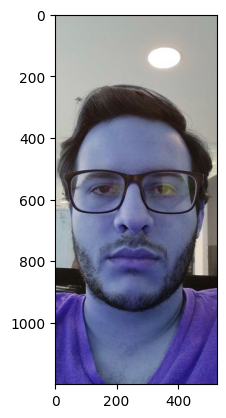

In [ ]:
plt.imshow(nova_img)

In [ ]:
np.savez_compressed('faces_embeddings_done_5classes.npz', embbeded_X, y)

In [ ]:
print(y)

['David_Brinkley' 'David_Brinkley' 'Joseph_Estrada' ... 'Sepp_Blatter'
 'Sepp_Blatter' 'marcelinho_no_db']


## Uma vez concluídas as etapas (1), (2) e (3), você deve usar esta imagem, que é a pessoa do item (3) usando máscara facial, e fazer o reconhecimento facial dela.

In [ ]:
data = np.load('faces_embeddings_done_5classes.npz')
embbeded_x_val = data['arr_0']
y_val = data['arr_1']

In [ ]:
print(embbeded_x_val.shape)
print(y_val.shape)

(12001, 512)
(12001,)


(436, 361, 3)

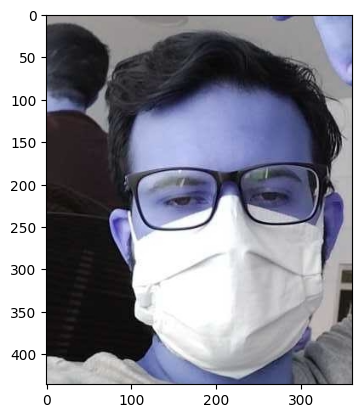

In [ ]:
nova_imagem_marcelino = cv.imread('/content/marcelinho_na_inferencia.jpg')
plt.imshow(nova_imagem_marcelino)
nova_imagem_marcelino.shape

In [ ]:
embedding_marcelino = get_embedding(nova_imagem_marcelino)

1/1 [==============================] - 0s 54ms/step


In [ ]:
from scipy.spatial.distance import euclidean
distancias = [euclidean(embedding_marcelino, embedding) for embedding in embbeded_x_val]
# Calcula a distância euclidiana entre embedding_marcelino e cada um dos embeddings na lista EMBEDDED_X_val

In [ ]:
indice_pessoa_similar = np.argmin(distancias) # econtra o indice da pessoa similar

In [ ]:
pessoa_similar = y_val[indice_pessoa_similar]
pessoa_similar

'James_Kopp'

Como pode ser visto, o resultado inferido foi de 'James_Kopp', que por sinal é bem semelhante ao Marcelino (imagem abaixo), no entanto, houve um equívoco do modelo ao inferir a classe certa.

- Acredito que uma coisa que pode ter influenciado nisso, foi a pouca quantidade de dados sobre o Marcelinho, com apenas uma imagem ao dataset (enquanto James_Kopp tem 6), que pode ter impulsionado o erro no modelo ao indicar a classe correta

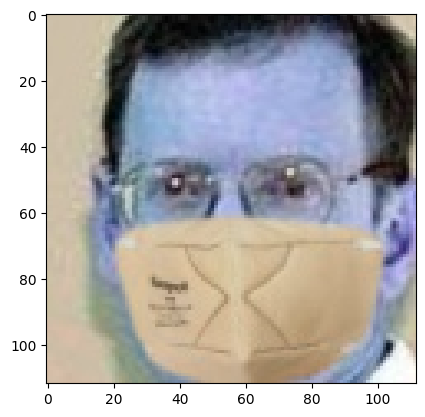

In [ ]:
james_kopp = cv.imread('/content/post-processed/James_Kopp/James_Kopp_0004_0001.jpg')
plt.imshow(james_kopp)